# 2.Prediction module

In this notebook, we demonstrate how to train tumor identification models and spatial gene expression prediction models using HiST prediction module based on 10x visium samples.

xx refers to the directory created by the function based on the date

Note: The test data only includes two samples, CRC1 and CRC2. The model weights we provide are obtained by training with 25 total samples iteratively using leave-one-out validation. Here, we only provide the running results.

## Import

In [ ]:
import os
import sys
sys.path.append('../src/')
import pickle
import numpy as np
import scanpy as sc
import pandas as pd
import PIL.Image as Image
from util.predict import *
from util.cluster import *
from util.seed import seed_torch
from FeatureExtraction.feature import load_features
from PredictionModule.solver import TumorSolver, GeneSolver


seed = 42
seed_torch(seed)
Image.MAX_IMAGE_PIXELS = 100000000000

## Samples

In [ ]:
sample_list = ['CRC1','CRC2','M1015','M1016','M1018T','M1022T',
                'M1026','M1037T','M1042T','M1051T',
                'M1054','M1055','M1058-2',
                'M1066T-I','M1067T-G','M1074',
                'M1083','M1084','M1088','M1111',
                'M1112','M1115','M1124','M1133','M2006']
gene_list = list(pd.read_csv('../resource/CRC_SVG346_list.txt',header=None).iloc[:,0])

print(len(sample_list),len(gene_list))

25 346


In [ ]:
all_sample_features = load_features('../output/features/all_sample_features.pkl')

## Train Tumor

### Leave-one-out

In [6]:
Tumorsolver = TumorSolver(
    seed = seed,
    mask_ch=1, img_ch=768, epochs=200, lr=0.001, weight_decay=1e-4, verbose=False
)

Log and model weights will be saved at ./checkpoint_tumor_loo/20240822



Training:   0%|           [ time left: ? ]

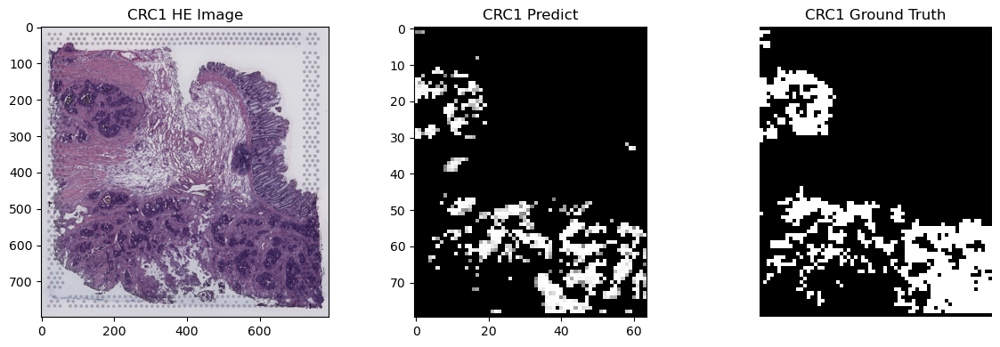


Training:   4%|▍          [ time left: 1:29:56 ]

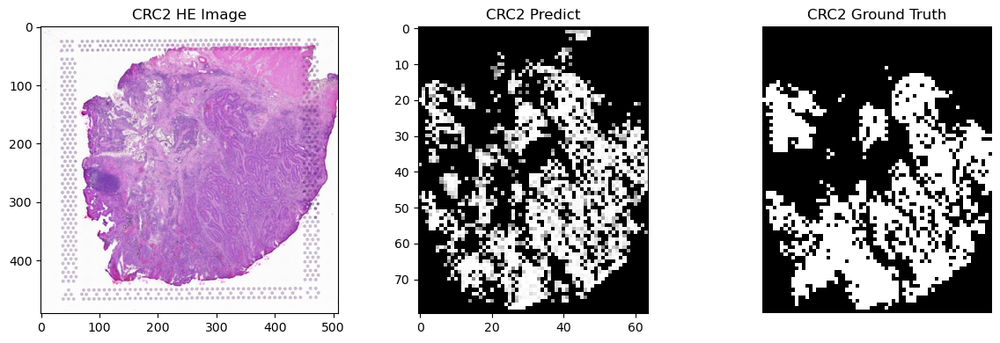


Training:   8%|▊          [ time left: 1:23:03 ]

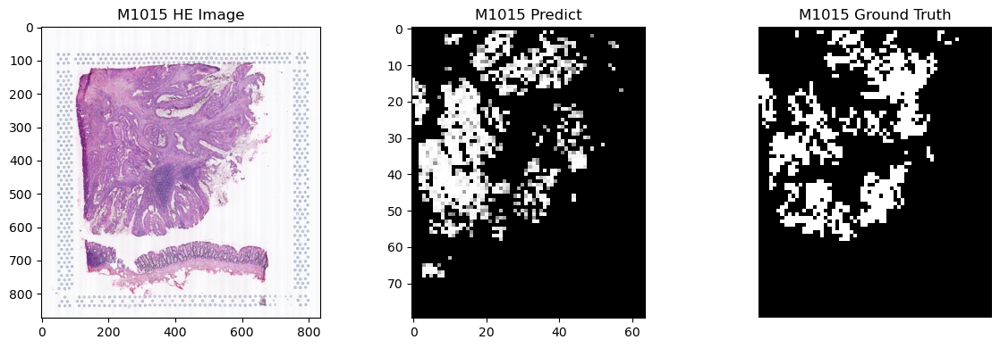


Training:  12%|█▏         [ time left: 1:17:44 ]

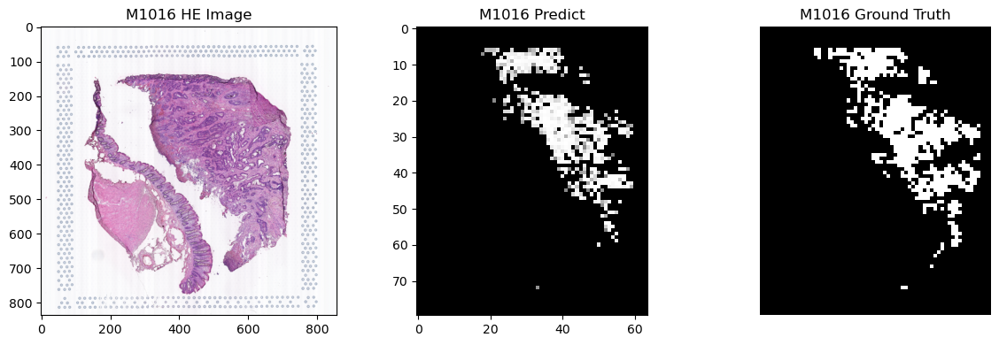


Training:  16%|█▌         [ time left: 1:12:19 ]

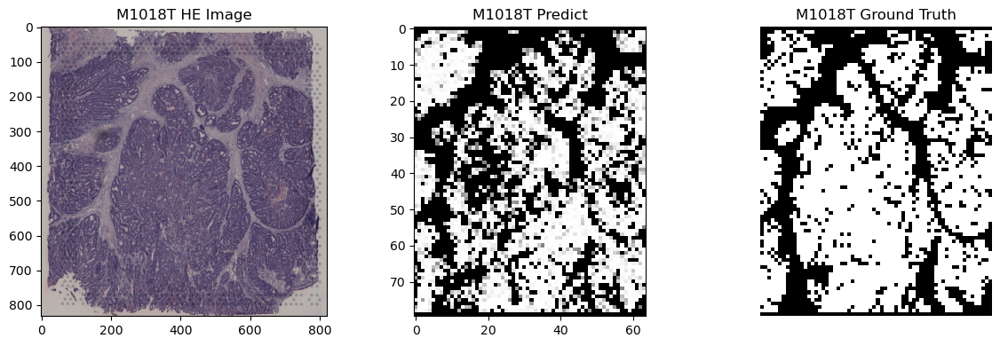


Training:  20%|██         [ time left: 1:07:07 ]

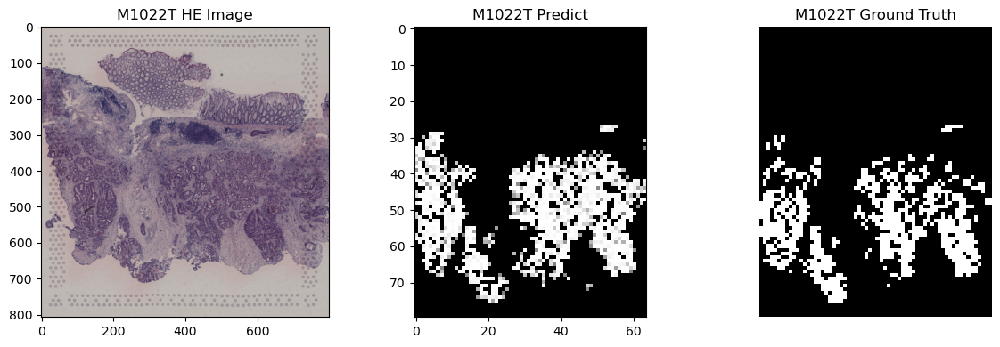


Training:  24%|██▍        [ time left: 1:19:17 ]

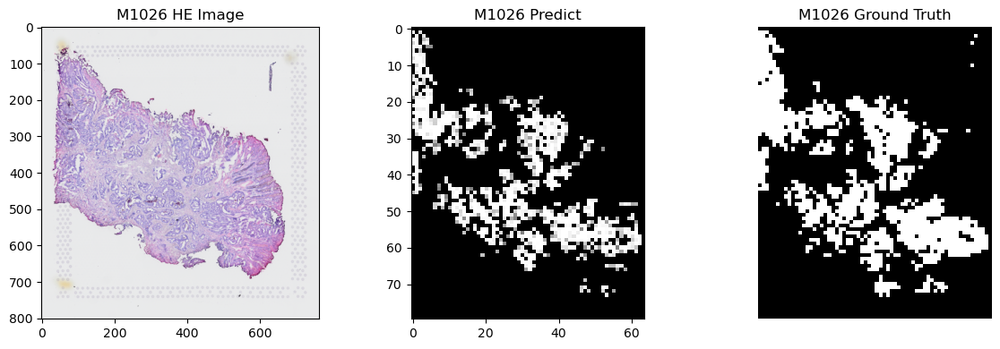


Training:  28%|██▊        [ time left: 1:24:51 ]

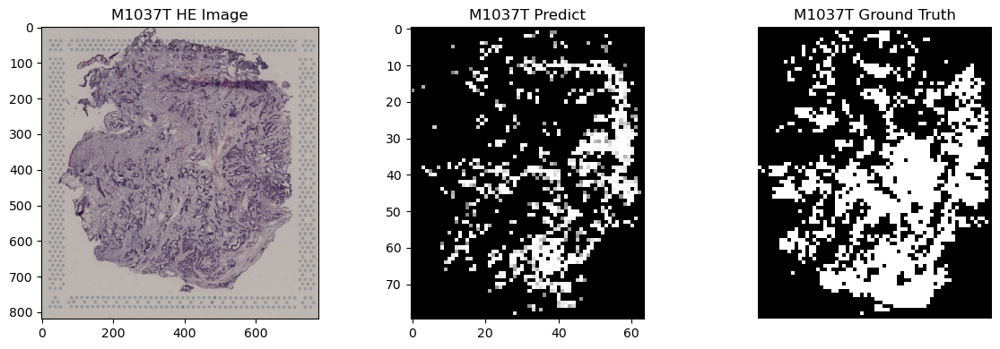


Training:  32%|███▏       [ time left: 1:26:22 ]

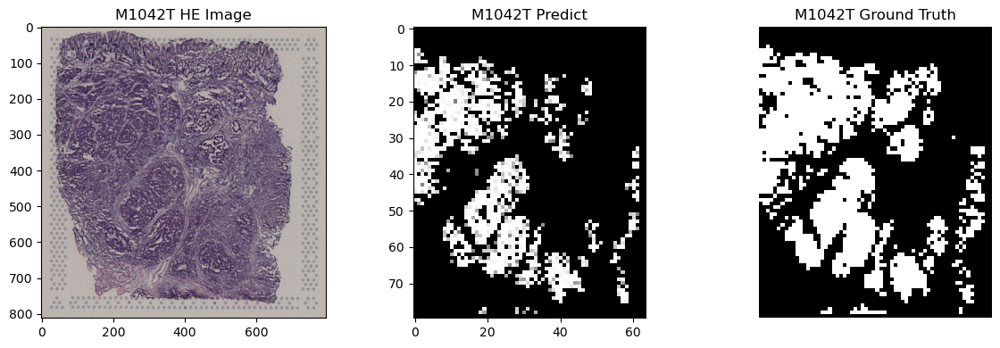


Training:  36%|███▌       [ time left: 1:25:02 ]

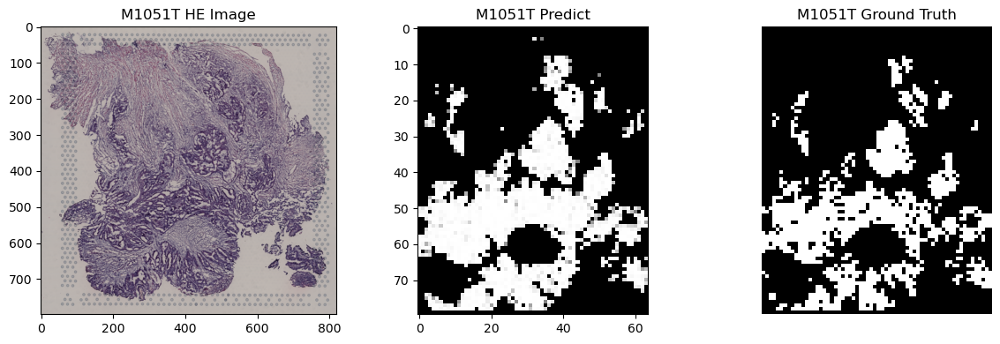


Training:  40%|████       [ time left: 1:22:16 ]

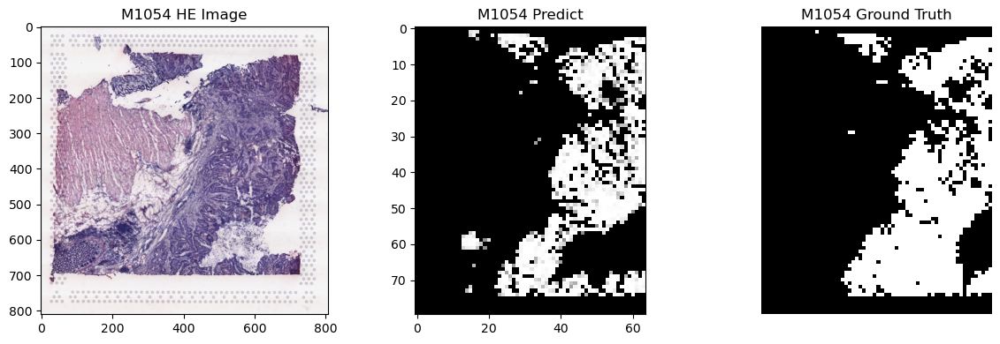


Training:  44%|████▍      [ time left: 1:19:12 ]

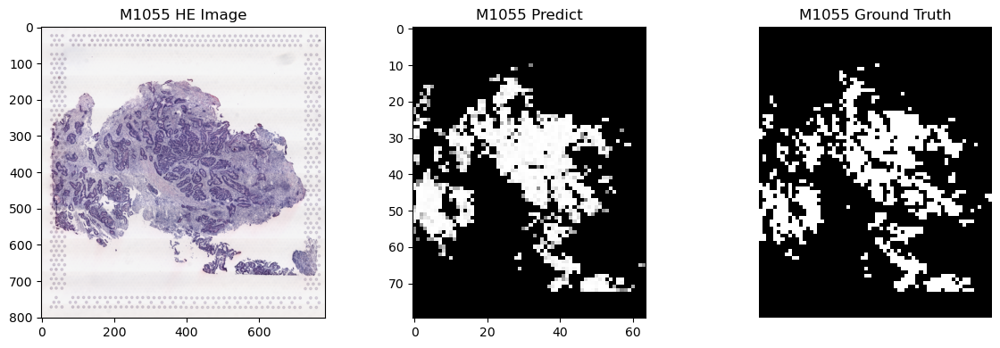


Training:  48%|████▊      [ time left: 1:14:16 ]

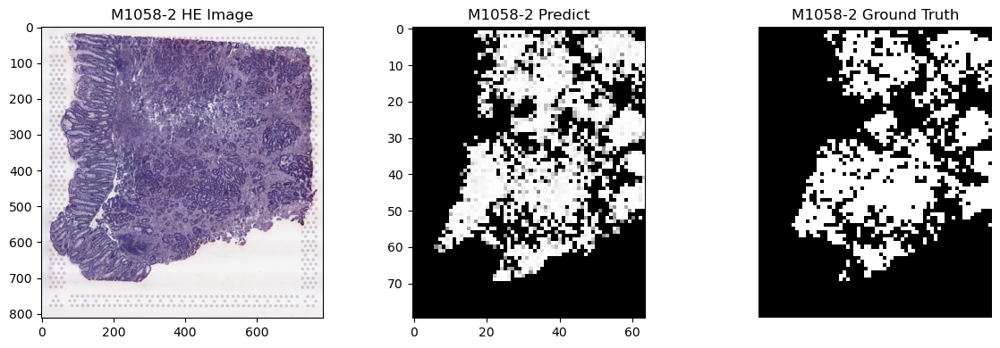


Training:  52%|█████▏     [ time left: 1:08:54 ]

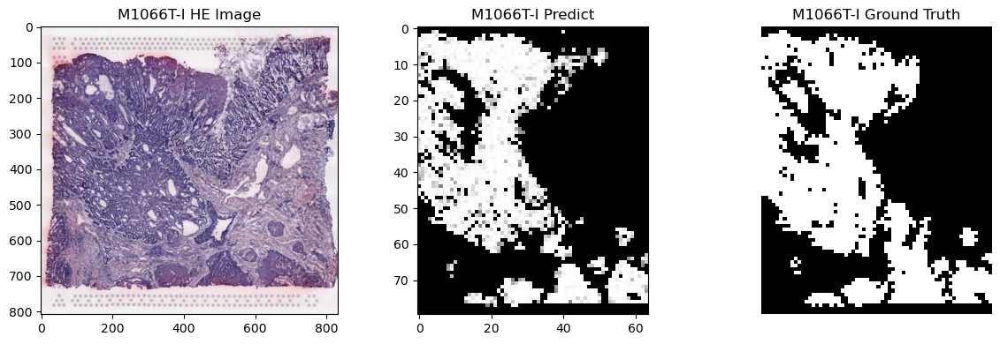


Training:  56%|█████▌     [ time left: 55:19 ]  

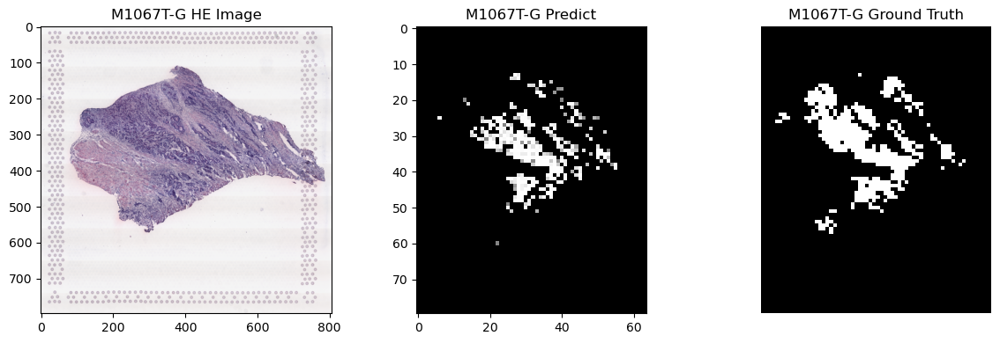


Training:  60%|██████     [ time left: 45:11 ]

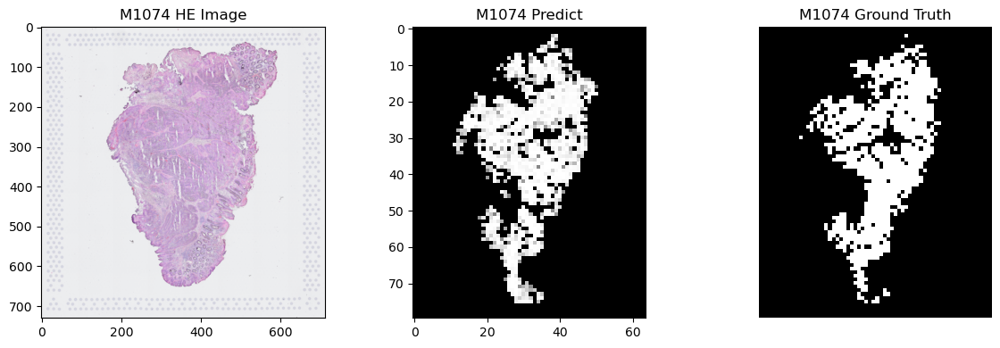


Training:  64%|██████▍    [ time left: 36:59 ]

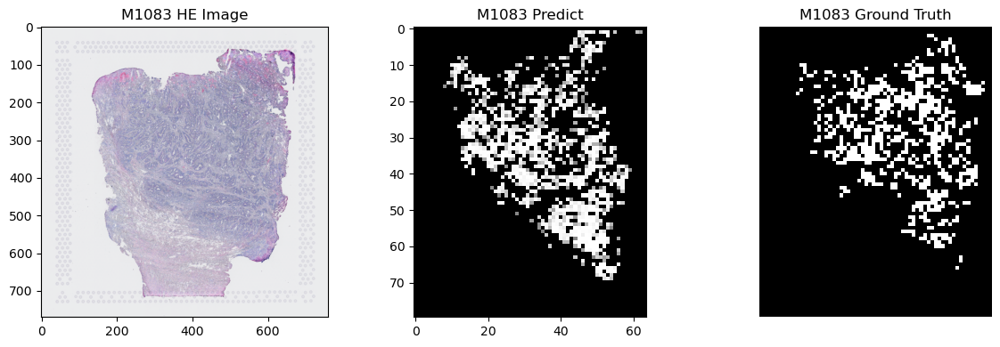


Training:  68%|██████▊    [ time left: 32:27 ]

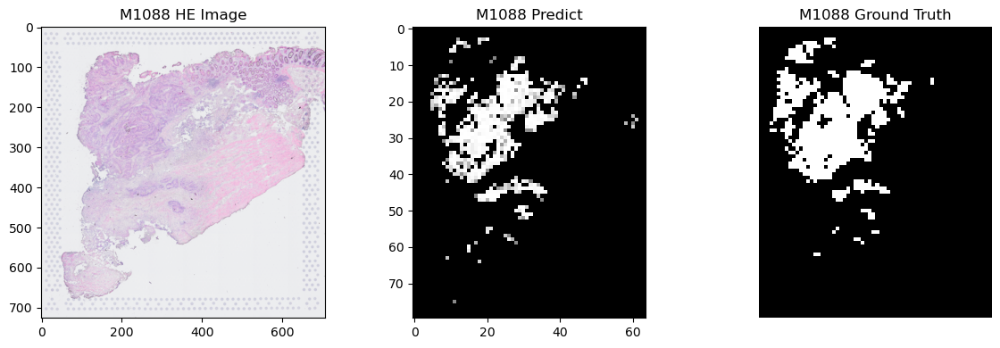


Training:  76%|███████▌   [ time left: 39:14 ]

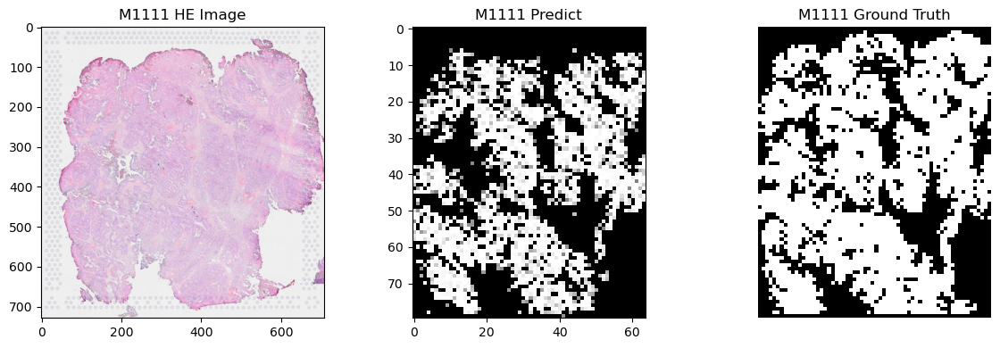


Training:  80%|████████   [ time left: 35:34 ]

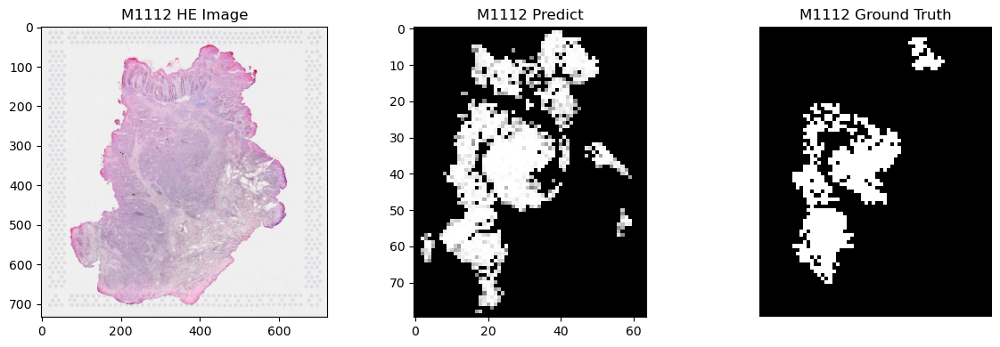


Training:  84%|████████▍  [ time left: 29:06 ]

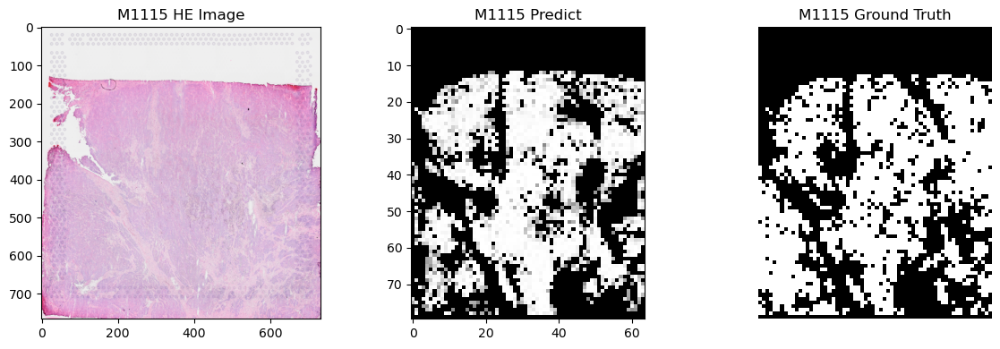


Training:  88%|████████▊  [ time left: 18:00 ]

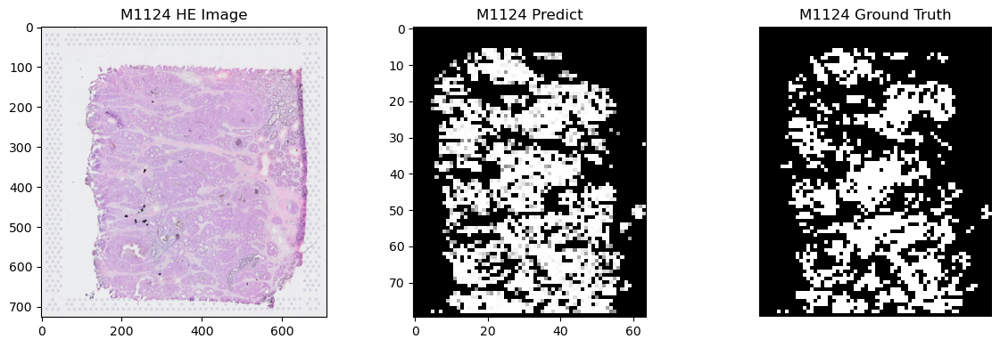


Training:  92%|█████████▏ [ time left: 10:12 ]

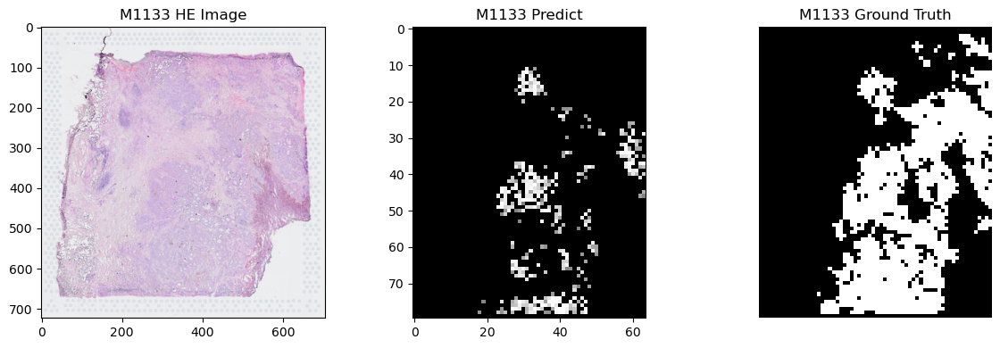


Training:  96%|█████████▌ [ time left: 04:27 ]

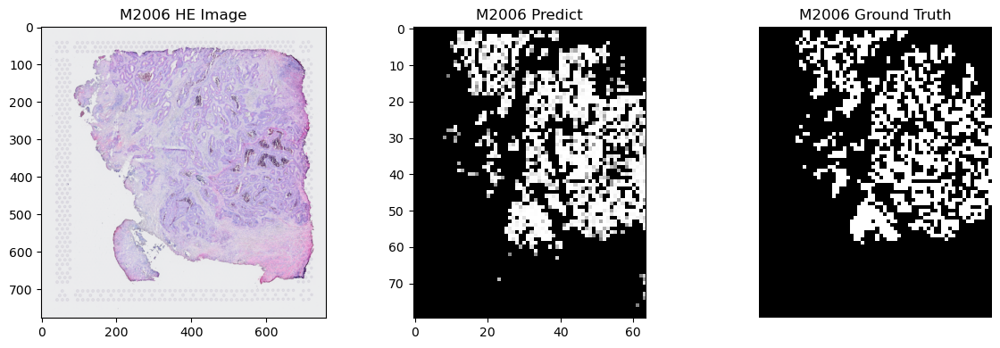

Training: 100%|██████████ [ time left: 00:00 ]

Predicted masks are saved at ./checkpoint_tumor_loo/20240822/predict_masks
Training is done!


In [ ]:
Tumorsolver.train_loo(
    sample_list=sample_list,
    all_sample_features=all_sample_features,
    batch_size=1,
    mask_dir='../output/mask_png',
    mask_ext='.png',
    HE_path='../data/hires_HE',
    HE_ext='_tissue_hires_image.png',
    out_dir='../output/model/tumor/checkpoint_loo/'
)

### Use all sample as training set

In [ ]:
# no validation
TumorModel_all = Tumorsolver.train_all(
    sample_list=sample_list,
    all_sample_features=all_sample_features,
    mask_dir='../output/mask_png',
    mask_ext='.png',
    out_dir='../output/model/tumor/checkpoint_all/'
)

In [ ]:
# load model
TumorModel_all = Tumorsolver.load_model(model_path='../output/model/tumor/checkpoint_all/xx/200_model.pth')

### Visualize leave-one-out validation HiST tumor segmentation results

In [ ]:
with open('../output/model/tumor/checkpoint_loo/xx/predict_masks/predict_masks.pkl', 'rb') as f:
    predict_masks = pickle.load(f)

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


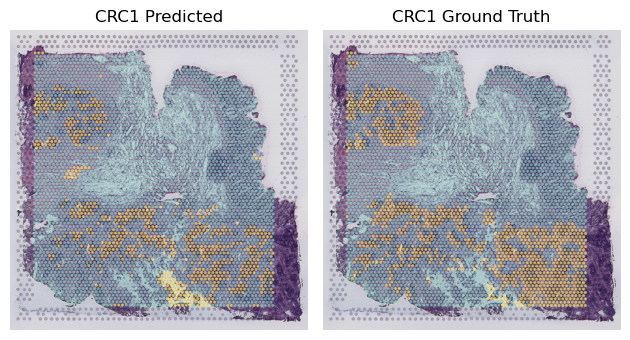

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


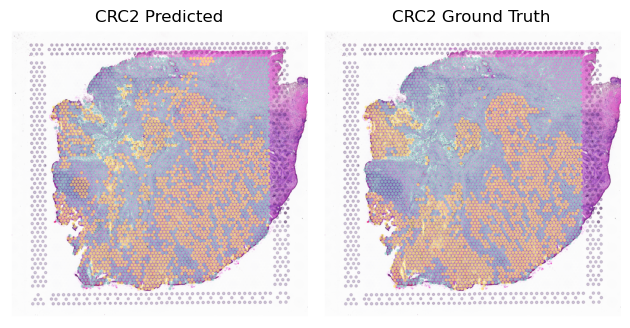

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


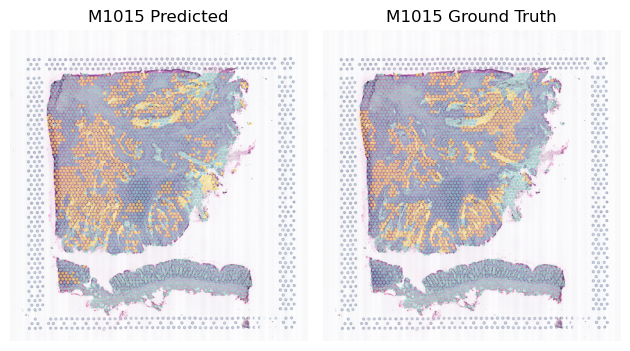

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


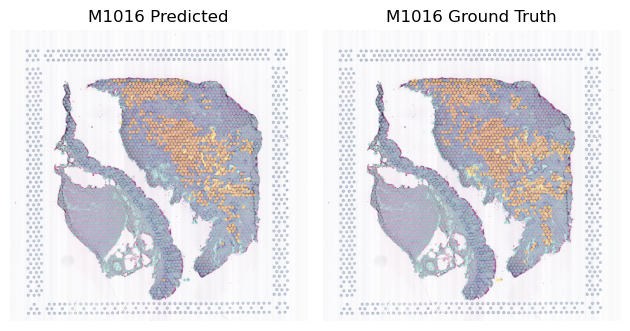

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


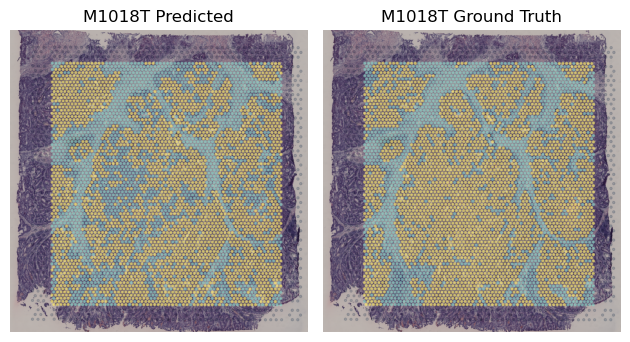

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


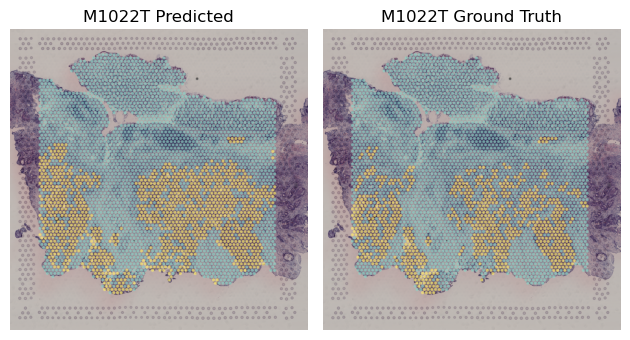

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


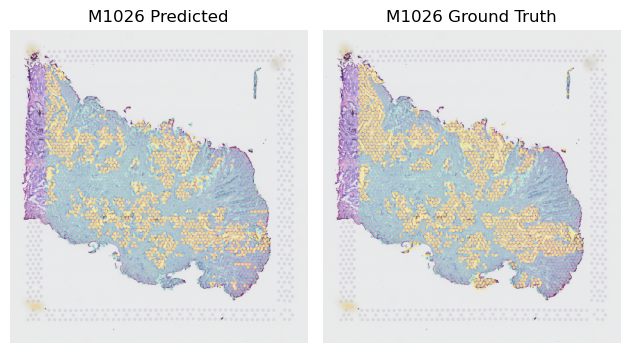

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


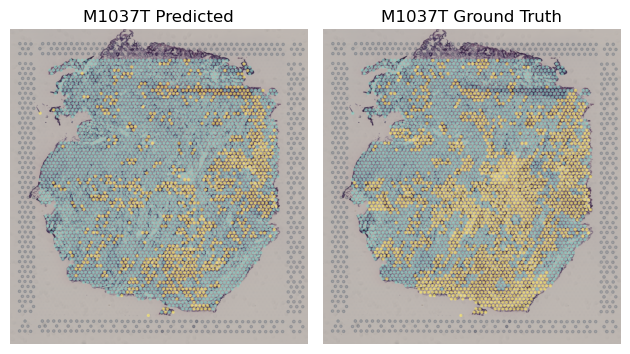

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


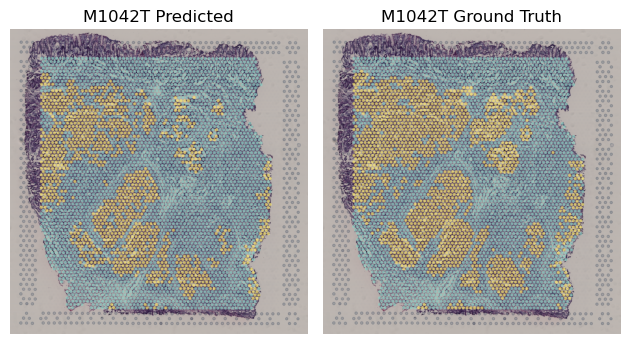

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


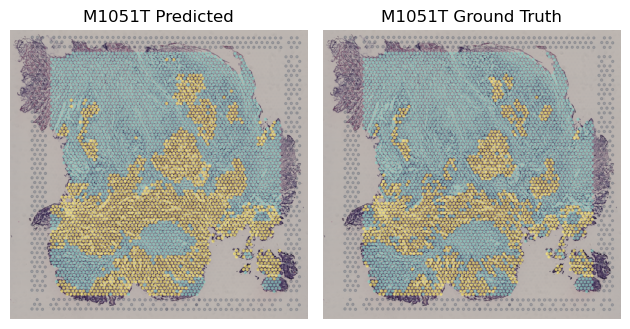

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


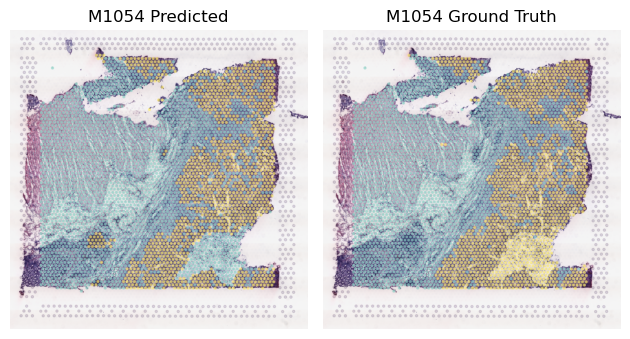

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


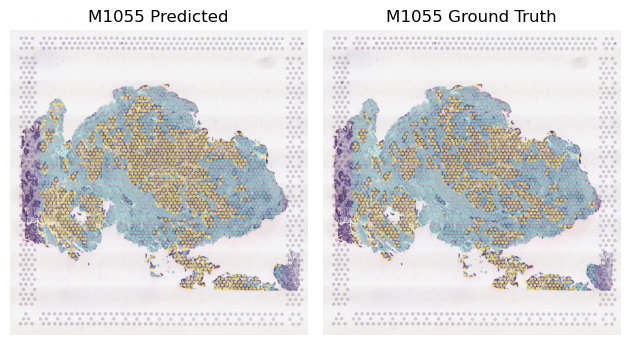

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


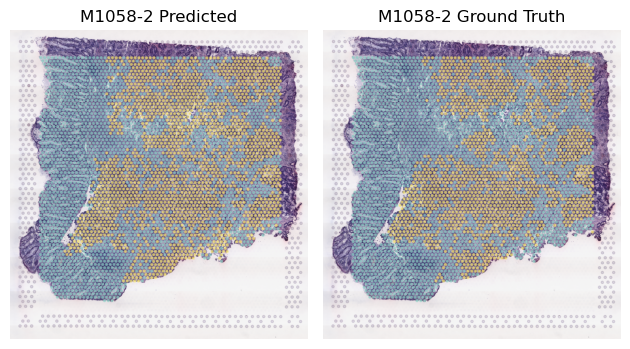

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


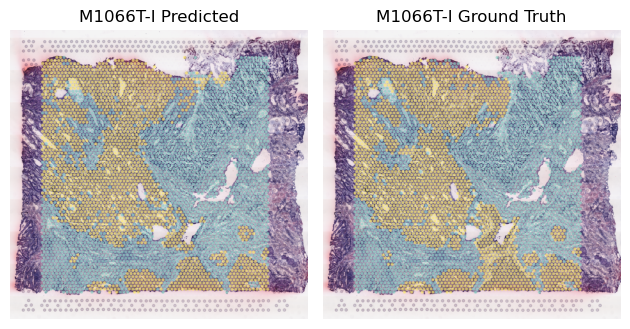

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


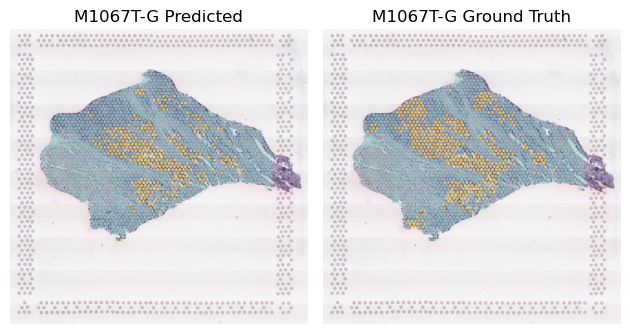

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


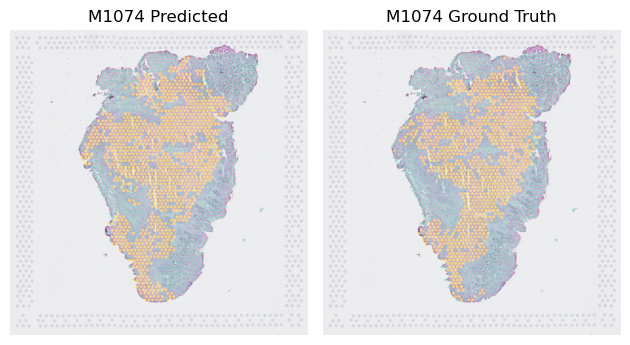

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


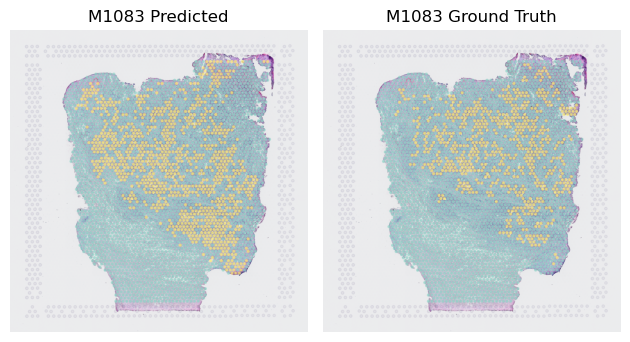

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


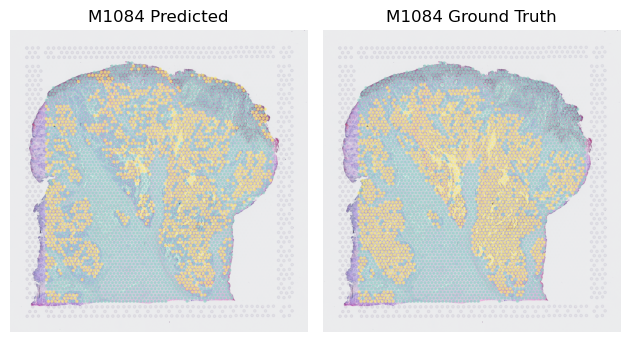

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


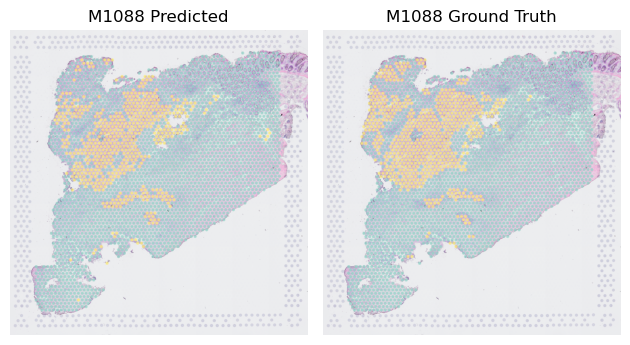

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


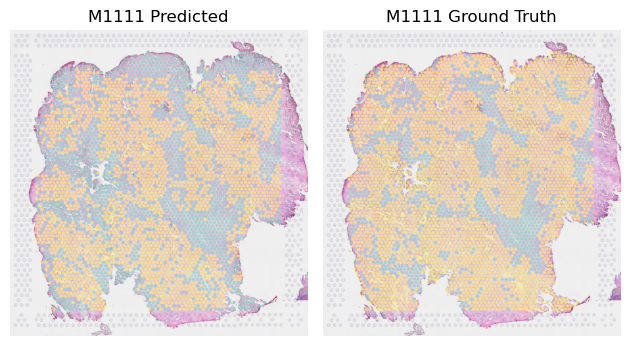

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


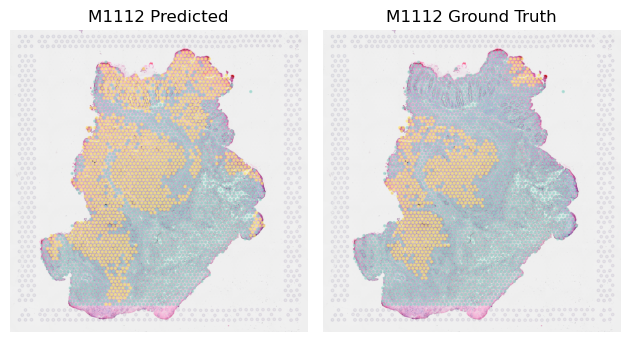

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


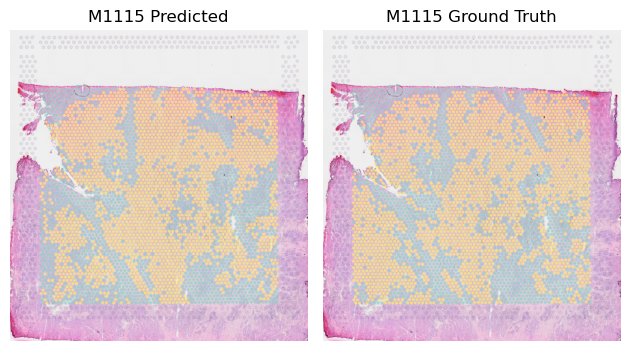

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


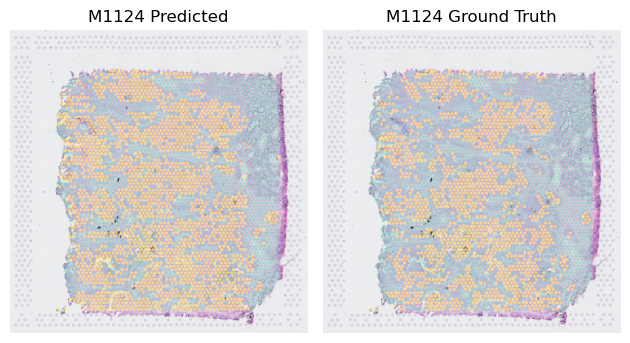

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


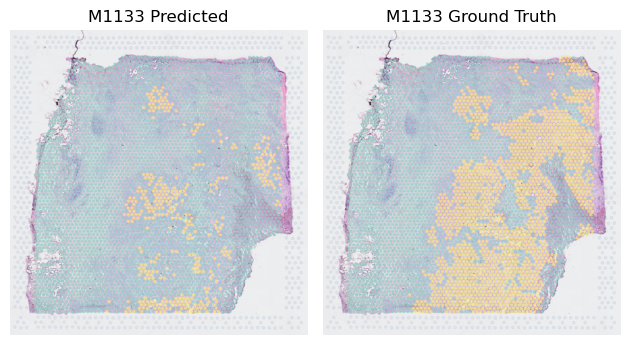

/tmp/ipykernel_41820/614216543.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap=plt.cm.get_cmap('Set3'),


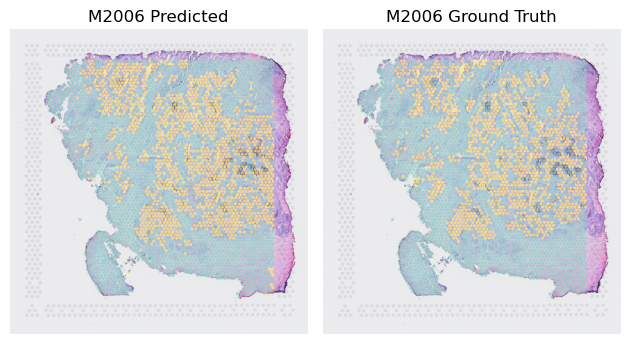

In [ ]:
for sample in sample_list:
    VisualizeTumorST(
            sample_id=sample,
            sample_list=sample_list,
            predict_masks=predict_masks,
            tissue_positions_path = '../output/tissue_positions_list/',
            scale_factor_path = '../output/scale_factor/',
            HE_path = '../data/HE/',
            mask_path = '../output/mask_png/0/',
            img_format = '.jpg',
            scale = True,
            predict=True,
            compare=True,
            alpha=0.5,
            cmap=plt.cm.get_cmap('Set3'),
            title=True
    )

## Train Gene

### Leave-one-out

In [8]:
Genesolver = GeneSolver(
    seed = seed,
    img_ch=768, epochs=200, lr=0.001, weight_decay=1e-4, verbose=False
)

In [ ]:
Genesolver.train_loo(
        gene_list=gene_list,
        sample_list=sample_list,
        all_sample_features=all_sample_features,
        batch_size=1,
        gene_dir='../output/geneMatrix/normed/',
        out_dir='../output/model/gene/checkpoint_loo/'
)

In [ ]:
pearson_df = pd.read_csv('../output/model/gene/checkpoint_loo/xx/cor_df/pearson_cor.csv',index_col=0)
spearman_df = pd.read_csv('../output/model/gene/checkpoint_loo/xx/cor_df/spearman_cor.csv',index_col=0)

In [6]:
print('Mean Pearson Correlation:',np.nanmean(pearson_df))
print('Mean Spearman Correlation:',np.nanmean(spearman_df))

Mean Pearson Correlation: 0.6242414404535507
Mean Spearman Correlation: 0.5014143571699207


In [ ]:
pearson_df.loc['EPCAM'].mean()

0.8397030484876169

### Use all samples as training set

In [ ]:
# no validation
GeneModel_all = Genesolver.train_all(
        gene_list=gene_list,
        sample_list=sample_list,
        all_sample_features=all_sample_features,
        gene_dir='../output/geneMatrix/normed/',
        out_dir='../output/model/gene/checkpoint_all/'
)

In [ ]:
# load model
GeneModel_all = Genesolver.load_model(model_path='../output/model/gene/checkpoint_all/xx/200_model.pth',
                                     gene_list=gene_list)

### Visualize leave-one-out validation HiST spatial gene prediction results

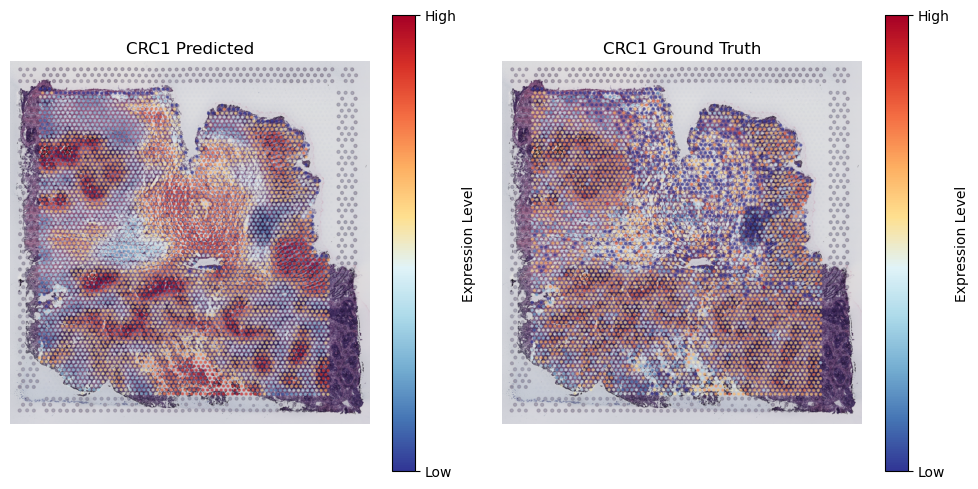

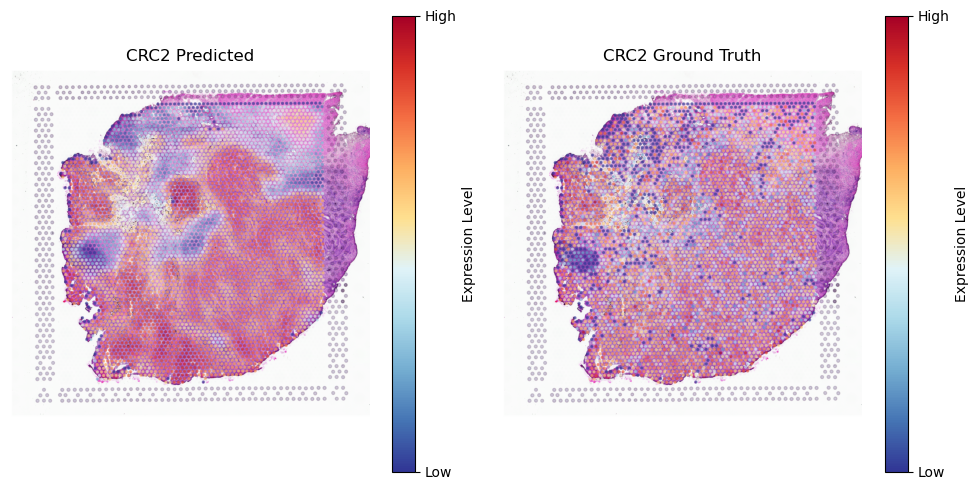

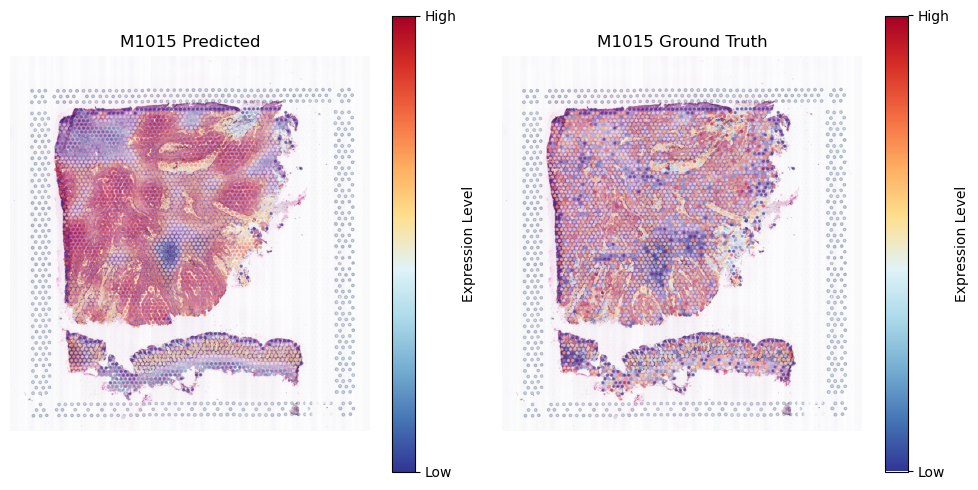

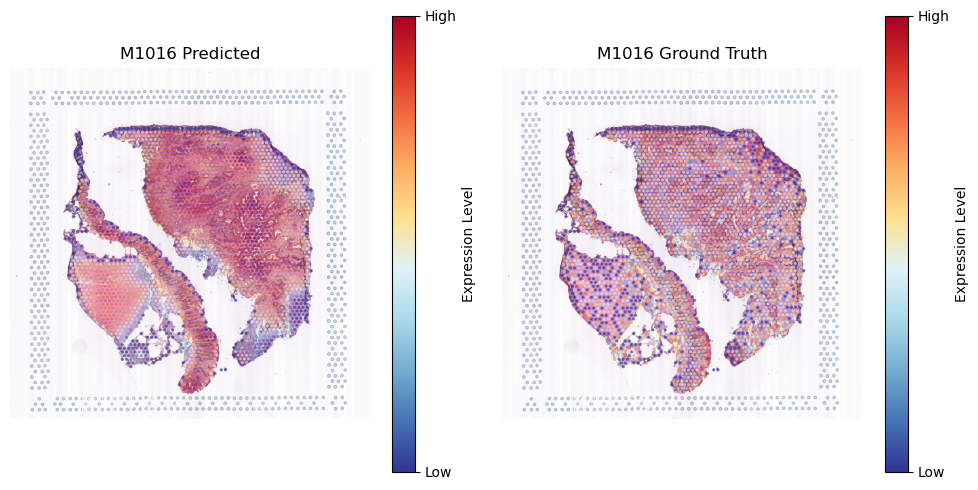

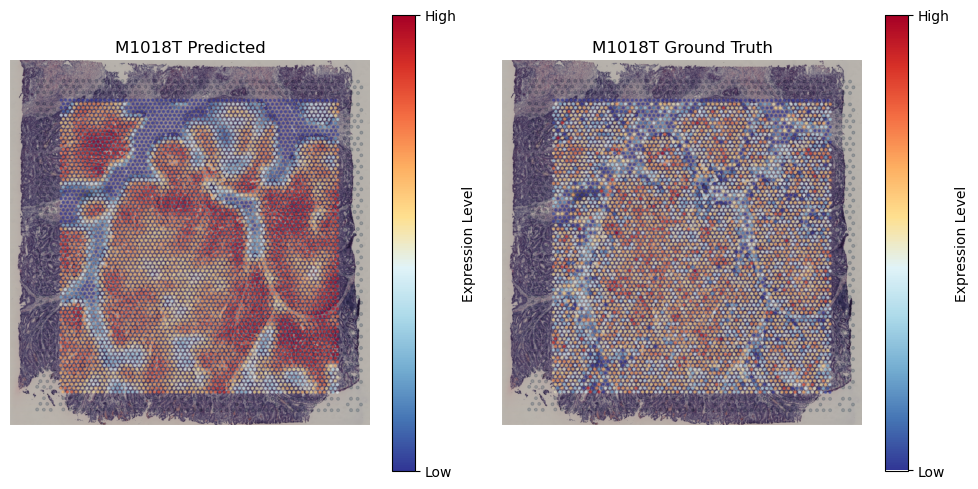

...

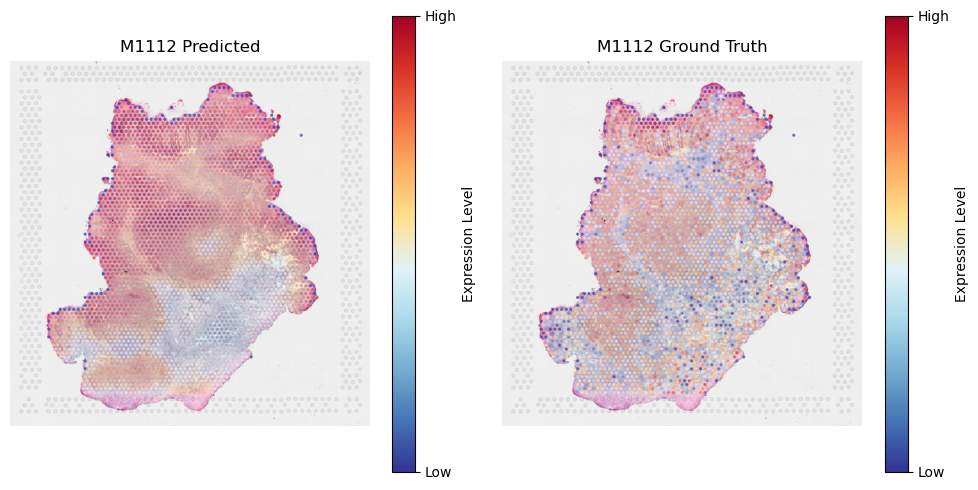

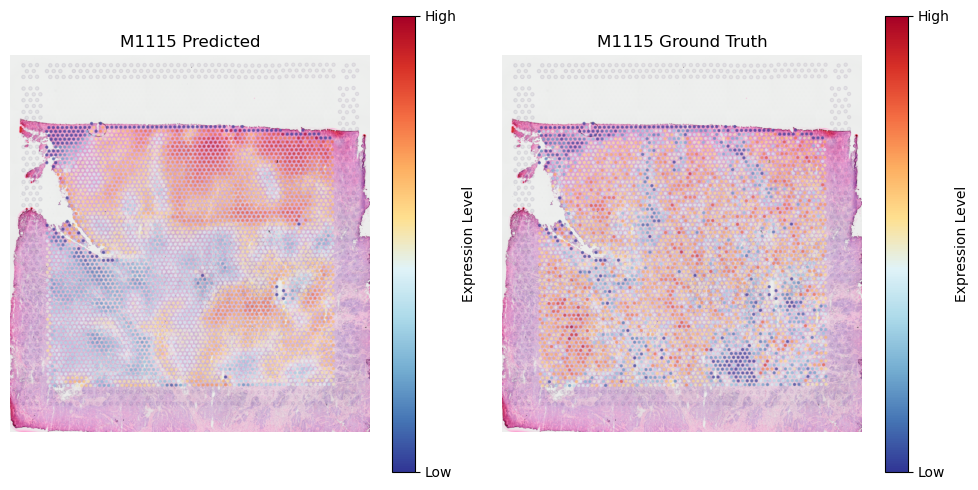

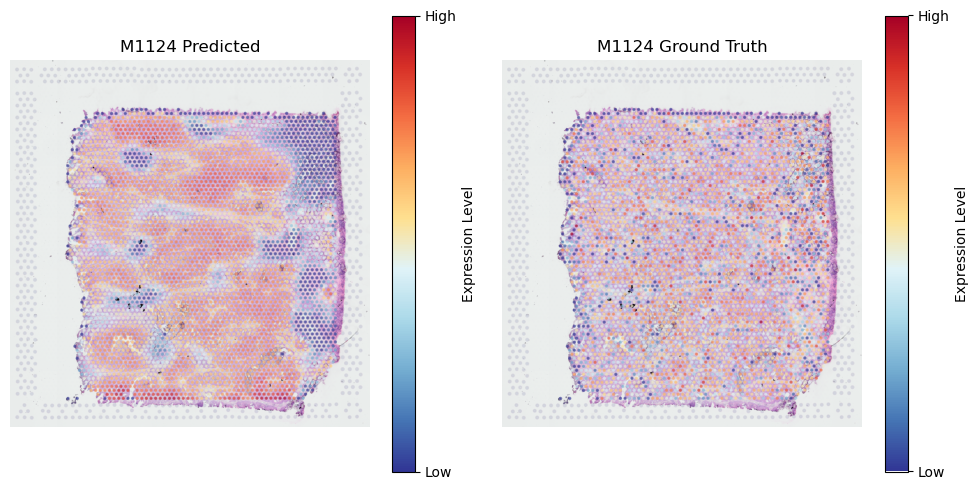

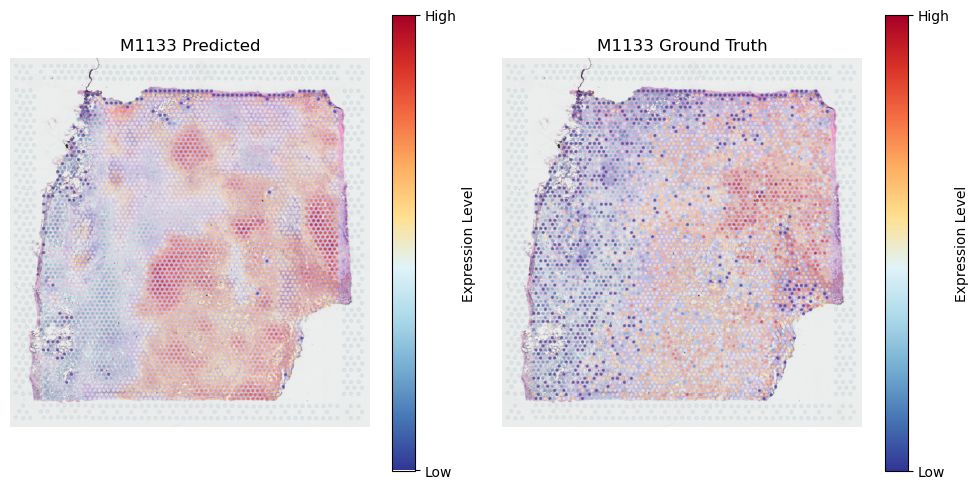

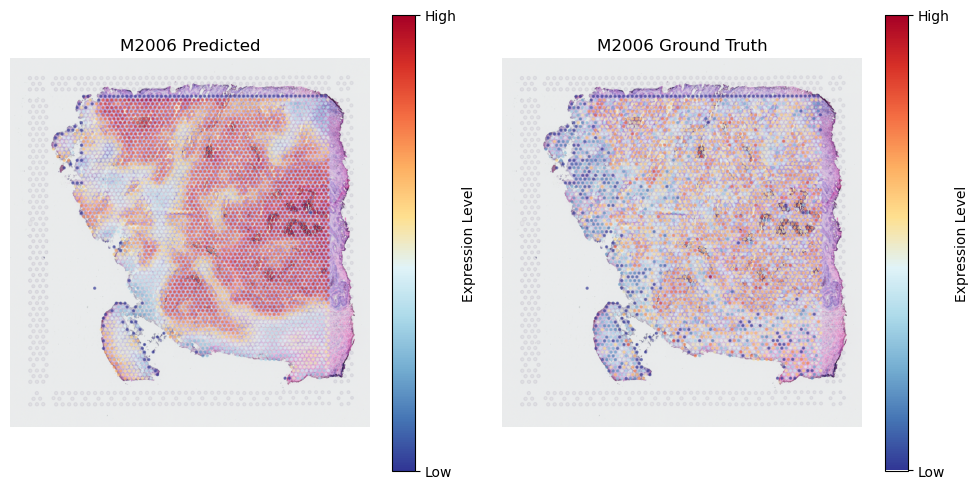

In [ ]:
for sample_id in sample_list:
    VisualizeGeneST(
        sample_id=sample_id,
        sample_list=sample_list,
        gene='EPCAM',
        gene_list=gene_list,
        all_sample_features=all_sample_features,
        model_path='../output/model/gene/checkpoint_loo/xx/last_model/'+sample_id+'_200_model.pth',
        rds_path='..output/geneMatrix/normed',
        tissue_positions_path='../output/tissue_positions_list/',
        scale_factor_path='../output/scale_factor/',
        HE_path='../data/hires_HE/',
        img_format='_tissue_hires_image.png',
        scale = False, #True if using full resolution images
        predict=True,
        compare=True,
        alpha=0.5,
        title=True,
    )

## Convert results to anndata

In [ ]:
sample_id = 'CRC1'
predict_gene_matrix,real_gene_matrix = ValidateSampleGene(
    sample_id=sample_id,
    sample_list=sample_list,
    gene_list=gene_list,
    all_sample_features=all_sample_features,
    model_path='../output/model/gene/checkpoint_loo/xx/last_model/'+sample_id+'_200_model.pth',
    rds_path='../output/geneMatrix/normed/'
)
predict_adata = Convert2Anndata(
    sample_id,
    predict_gene_matrix,
    gene_list,
    tissue_positions_path='../output/tissue_positions_list/',
    scale_factor_path='../output/scale_factor/',
    HE_path='../data/hires_HE/',
    img_format='_tissue_hires_image.png'
)
true_adata = Convert2Anndata(
    sample_id,
    real_gene_matrix,
    gene_list,
    tissue_positions_path='../output/tissue_positions_list/',
    scale_factor_path='../output/scale_factor/',
    HE_path='../data/hires_HE/',
    img_format='_tissue_hires_image.png'
)

In [ ]:
predict_adata

AnnData object with n_obs × n_vars = 4457 × 346
    obs: 'in_tissue', 'array_row', 'array_col', 'imagerow', 'imagecol'
    var: 'feature_types'
    uns: 'spatial'
    obsm: 'spatial'

In [ ]:
mask_dir='../output/mask_png/0/CRC1.png'
CRC1_true_mask = np.array(Image.open(mask_dir))
with open('../output/model/tumor/checkpoint_loo/xx/predict_masks/predict_masks.pkl','rb') as f:
    predict_masks_list = pickle.load(f)
CRC1_predict_mask = predict_masks_list[sample_list.index("CRC1")]

In [ ]:
true_adata.obs['is_tumor'] = mask2col(true_adata,CRC1_true_mask)
predict_adata.obs['is_tumor'] = mask2col(predict_adata,CRC1_predict_mask)

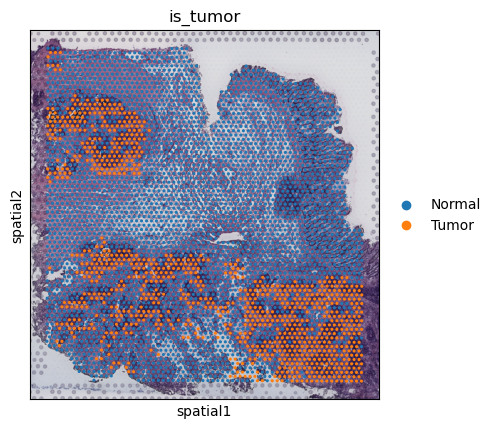

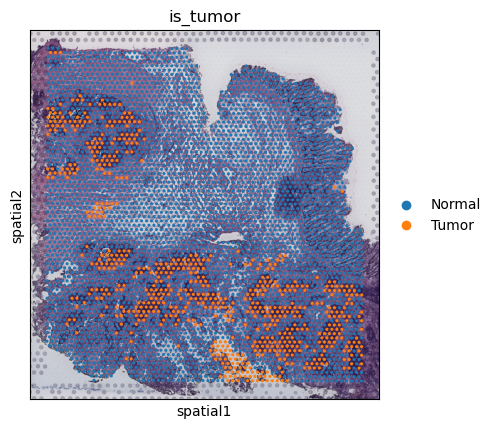

In [ ]:
sc.pl.spatial(true_adata,color = "is_tumor",size = 1000)
sc.pl.spatial(predict_adata,color = "is_tumor",size = 1000)

## Load model from pretrained weights

In [ ]:
Tumorsolver = TumorSolver(
    seed = seed,
    mask_ch=1, img_ch=768, epochs=200, lr=0.001, weight_decay=1e-4, verbose=False
)
tumor_model = Tumorsolver.load_model(model_path='../output/model/tumor/checkpoint_all/xx/200_model.pth')

In [ ]:
Genesolver = GeneSolver(
    seed = seed,
    img_ch=768, epochs=200, lr=0.001, weight_decay=1e-4, verbose=False
)
gene_model = Genesolver.load_model(model_path='../output/model/gene/checkpoint_all/xx/200_model.pth',gene_list=gene_list)